<h1 align="center"></h1>
<h1 align="center">Problem 1 - Building an HBM</h1>
<h2 align="center">Hierarchical Bayesian Modeling of a Single Gaussian Population with PyStan and PyJAGS</h2>
<div align="center">Simulating the distribution of "$\boldsymbol{e \cos \omega}$" for hot Jupiter exoplanets from  <i>Kepler</i>. These simulated exoplanet candiates are potentially undergoing migration and orbital circularization. </div> 
<h4 align="center">LSSTC DSFP Session 4, September 21st, 2017</h4>
<h5 align="center">Author: Megan I. Shabram, PhD, 
NASA Postdoctoral Program Fellow,  mshabram@gmail.com</h5>

In [28]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pyjags
import pystan
import pickle
import triangle_linear


from __future__ import division, print_function
from pandas.tools.plotting import *
from matplotlib import rcParams
rcParams["savefig.dpi"] = 100
rcParams["font.size"] = 20
#plt.style.use('ggplot')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
#%qtconsole


In [29]:
## function to draw from truncated normal, this function will be used for both the 
## one- and two-componenet cases in this workbook.  

def rnorm_bound( Ndata, mu, prec, lower_bound = 0.0, upper_bound = float('Inf')):
    x = np.zeros(Ndata)
    #print(x)
    for i in range(0, Ndata): 
            #print(i)
            while True:
                x[i] = np.random.normal(mu,prec,1)
                if( (x[i]>lower_bound) and (x[i]<upper_bound) ): 
                    break
    return x;

[-0.08414891  0.24890503 -0.34536642 -0.05179949  0.14671858 -0.48287003
 -0.35982726 -0.06661722  0.06850514 -0.00484616 -0.0106205  -0.31568754
  0.00156278 -0.0647396   0.23104266  0.03157824  0.34639807 -0.06500773
 -0.86266563 -0.00404338 -0.52611497  0.12748574 -0.36638884  0.07374836
  0.08386973] [-0.03936191  0.20865605 -0.3453645  -0.01925352  0.17564901 -0.47575206
 -0.38983001 -0.07469232  0.05815261  0.01971244 -0.0306394  -0.38072156
 -0.00696299 -0.10032997  0.24709073  0.05734933  0.39321062 -0.05280035
 -0.8510956   0.05089368 -0.53323758  0.16827932 -0.45053209 -0.0074478
  0.14821088]


(array([ 1.,  0.,  1.,  4.,  1.,  0.,  9.,  3.,  5.,  1.]),
 array([-0.8510956 , -0.72666498, -0.60223436, -0.47780374, -0.35337311,
        -0.22894249, -0.10451187,  0.01991875,  0.14434937,  0.26878   ,
         0.39321062]),
 <a list of 10 Patch objects>)

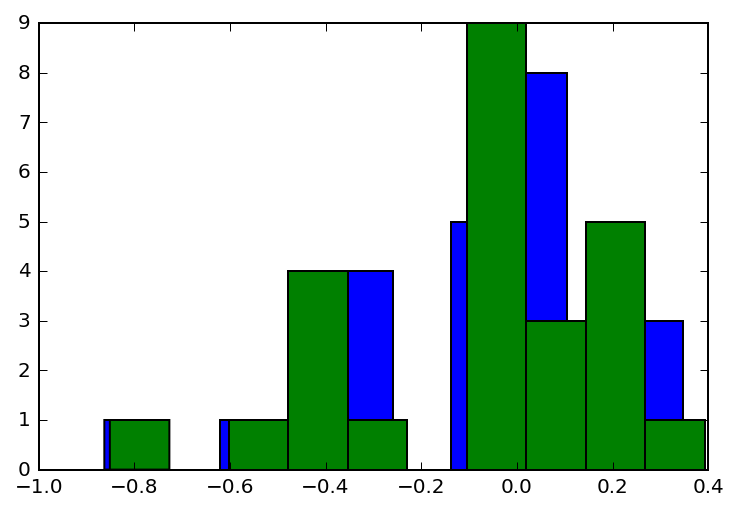

In [30]:
## One-component Gaussian Mixture Simulated Data
## Below we designate the population values of our generative model. These are the 
## truths that we should recover if our hiararchical Bayesian model is properly specified 
## and diagnostics have indicated that the simulation has "not not converged". "You can't 
## prove convergence, at best you can fail to prove a failure to converge".

## In this simulated data set, their are 50 planetary systems (with one planet each)
Ndata = 25 
## Here we asign the dispersion of the simulated population to be 0.3, this is 
## the truth we wish to recovern 
sigmae = 0.3 
## We approximate the uncertainty for each measurement as normally distributed about a 
## reporte measurement point estimate.  For the eccentricity distribution for Hot Jupiter
## the physical models used to derive these produce larger uncertainty in k by a factor of 2. 
sigmahobs = 0.04

h = np.repeat(0.,Ndata)
hhat = np.repeat(0.,Ndata)
hhat_sigma  = np.repeat(sigmahobs,Ndata)

#print(khat_sigma)


for i in range(0,Ndata):
    h[i] = rnorm_bound(1,0,sigmae,lower_bound=-1,upper_bound=1)
    hhat[i] = rnorm_bound(1,h[i],sigmahobs,lower_bound=-1,upper_bound=1)

## Vizualize the true data values, and the simulated measurements:     
print(h, hhat)
plt.hist(h)
plt.hist(hhat)

In [32]:
eccmodel = """
data {
    int<lower=1> Ndata;
    real<lower=-1,upper=1> hhat[Ndata];
    real<lower=0,upper=1> hhat_sigma[Ndata];
}
parameters {
    real<lower=0> e_sigma;
    real<lower=-1,upper=1> h[Ndata];
}
model {

    e_sigma ~ uniform(0, 1.0);
    
    for (n in 1:Ndata)
      hhat[n] ~ normal(h[n], hhat_sigma[n]);
    
    for (n in 1:Ndata)
      increment_log_prob(normal_log(h[n], 0.0, e_sigma));
}
"""
# Compiled Stan Model
sm = pystan.StanModel(model_code=eccmodel)

In [33]:
ecc_dat = {'Ndata': len(hhat), 'hhat': hhat, 'hhat_sigma': hhat_sigma}


fit = sm.sampling(data=ecc_dat, iter=10000, chains=4, seed=483892929, refresh=1000, n_jobs=-1)



//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
When unpickling the StanModel must be unpickled first.
  return send(obj)
//anaconda/lib/python2.7/multiprocessing/queues.py:392: UserWarning: Pickling fit objects is an experimental feature!
The relevant StanModel instance must be pickled along with this fit object.
Wh

In [34]:
print(fit)

Inference for Stan model: anon_model_438b4e266a27bc779461f05007a9a701.
4 chains, each with iter=10000; warmup=5000; thin=1; 
post-warmup draws per chain=5000, total post-warmup draws=20000.

          mean se_mean     sd   2.5%    25%    50%    75%  97.5%  n_eff   Rhat
e_sigma   0.31  3.4e-4   0.05   0.23   0.28   0.31   0.34   0.42  20000    1.0
h[0]     -0.04  2.8e-4   0.04  -0.12  -0.07  -0.04  -0.01   0.04  20000    1.0
h[1]       0.2  2.8e-4   0.04   0.13   0.18   0.21   0.23   0.28  20000    1.0
h[2]     -0.34  2.8e-4   0.04  -0.42  -0.37  -0.34  -0.31  -0.26  20000    1.0
h[3]     -0.02  2.8e-4   0.04   -0.1  -0.05  -0.02 8.5e-3   0.06  20000    1.0
h[4]      0.17  2.8e-4   0.04    0.1   0.15   0.17    0.2   0.25  20000    1.0
h[5]     -0.47  2.8e-4   0.04  -0.55  -0.49  -0.47  -0.44  -0.39  20000    1.0
h[6]     -0.38  2.8e-4   0.04  -0.46  -0.41  -0.38  -0.36   -0.3  20000    1.0
h[7]     -0.07  2.8e-4   0.04  -0.15   -0.1  -0.07  -0.05 4.4e-3  20000    1.0
h[8]      0.06  2.8

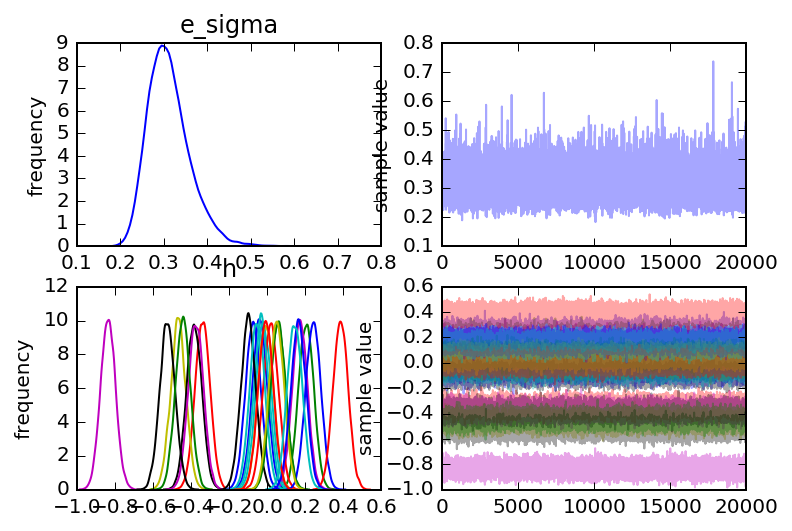

In [35]:
fig = fit.traceplot()

In [36]:
la = fit.extract(permuted=True)  # return a dictionary of arrays

a = fit.extract(permuted=False)

e_sigma = la['e_sigma'].reshape(4,5000)
print(e_sigma.shape)
#print(la.shape)
#print(e_sigma.reshape(4,5000))

(4, 5000)


In [37]:
num_chains = 4

df = pd.DataFrame(la.items())
print(df)
print(df.keys())
samples_Stan = dict(zip(df[0], df[1].values ))
#print(samples.items())
print(type(samples_Stan['e_sigma']))
print(samples_Stan.items())
#for j, i in samples.items():
#    print(j)
#    print(i.shape)

         0                                                  1
0  e_sigma  [0.326409497452, 0.345991055691, 0.27714526356...
1        h  [[-0.00962408418405, 0.190996274691, -0.370738...
2     lp__  [-39.6772031217, -42.0183319796, -44.357320141...
RangeIndex(start=0, stop=2, step=1)
<type 'numpy.ndarray'>
[(u'h', array([[ -9.62408418e-03,   1.90996275e-01,  -3.70738056e-01, ...,
         -5.40537962e-01,   1.74743909e-02,   9.63395684e-02],
       [ -3.73987441e-02,   2.42461387e-01,  -3.56098935e-01, ...,
         -3.94076190e-01,  -6.79924376e-02,   5.56223837e-02],
       [ -1.07263225e-01,   1.48771906e-01,  -3.50645873e-01, ...,
         -4.51418970e-01,  -5.15351486e-02,   1.45821180e-01],
       ..., 
       [ -1.51065684e-02,   1.98597023e-01,  -3.46570924e-01, ...,
         -4.26445593e-01,   5.70493711e-02,   1.36314980e-01],
       [ -4.39818666e-02,   1.51305876e-01,  -3.19311538e-01, ...,
         -4.75067017e-01,  -2.84349944e-02,   1.67350173e-01],
       [ -7.61842338e-

In [38]:

## Print and check the shape of the resultant samples dictionary:
#print(samples)
#print(samples.items())
print('-----')
print(samples_Stan['e_sigma'].shape)
print(samples_Stan['h'].shape)
print(samples_Stan['h'][:,3].shape)
print('-----')


## Update the samples dictionary so that it includes keys for the latent variables
## Also, we will use LaTeX formatting to help make legible plots ahead.  
samples_Nm1_Stan = {}

## adjust the thin varible to only look at every #th population element 
thin1 = 1

## Need to enter the number of hyperparameter variables here:
numHyperParams = 1

## Specify the dimension we want for our plot below, for legibility.  
dim1 = (Ndata/thin1) + numHyperParams
print(dim1)

for i in np.arange(0,Ndata,thin1):
    samples_Nm1_Stan.update({'$h_{'+str(i+1)+'}$': samples_Stan['h'][:,i]})

## Add the hyperparameter marginal posterior back in:
samples_Nm1_Stan.update({'$e_{\sigma}$': samples_Stan['e_sigma']})
print(samples_Nm1_Stan['$h_{5}$'].shape)

## Reshape values for diagnostic plot functions (trace, autocorrelation) below:  
samples_Nm1_trace_Stan = {}    
for j, i in samples_Nm1_Stan.items():
    samples_Nm1_trace_Stan.update({str(j): i.reshape(int(len(i)/num_chains),-1)})




-----
(20000,)
(20000, 25)
(20000,)
-----
26.0
(20000,)


In [39]:
## equal tailed 95% credible intervals, and posterior distribution means:
def summary(samples, varname, p=95):
    values = samples[varname][0]
    ci = np.percentile(values, [100-p, p])
    print('{:<6} mean = {:>5.1f}, {}% credible interval [{:>4.1f} {:>4.1f}]'.format(
      varname, np.mean(values), p, *ci))

for varname in samples_Nm1_trace_Stan:
    summary(samples_Nm1_trace_Stan, varname)


$h_{2}$ mean =   0.2, 95% credible interval [ 0.2  0.2]
$h_{21}$ mean =  -0.5, 95% credible interval [-0.6 -0.4]
$h_{12}$ mean =  -0.4, 95% credible interval [-0.4 -0.4]
$h_{3}$ mean =  -0.4, 95% credible interval [-0.4 -0.4]
$h_{14}$ mean =  -0.2, 95% credible interval [-0.2 -0.1]
$h_{20}$ mean =   0.0, 95% credible interval [ 0.0  0.1]
$h_{22}$ mean =   0.2, 95% credible interval [ 0.1  0.2]
$h_{15}$ mean =   0.2, 95% credible interval [ 0.2  0.3]
$h_{17}$ mean =   0.4, 95% credible interval [ 0.4  0.4]
$h_{5}$ mean =   0.2, 95% credible interval [ 0.1  0.2]
$h_{13}$ mean =  -0.0, 95% credible interval [-0.0  0.1]
$h_{18}$ mean =  -0.1, 95% credible interval [-0.1 -0.0]
$h_{9}$ mean =   0.1, 95% credible interval [ 0.0  0.1]
$h_{19}$ mean =  -0.8, 95% credible interval [-0.9 -0.8]
$e_{\sigma}$ mean =   0.3, 95% credible interval [ 0.3  0.4]
$h_{16}$ mean =   0.0, 95% credible interval [-0.0  0.1]
$h_{4}$ mean =   0.0, 95% credible interval [-0.0  0.0]
$h_{24}$ mean =  -0.0, 95% credi

Variable
$e_{\sigma}$    0.311834
$h_{10}$        0.019147
$h_{11}$       -0.030019
$h_{12}$       -0.374076
$h_{13}$       -0.006792
$h_{14}$       -0.098501
$h_{15}$        0.243153
$h_{16}$        0.056563
$h_{17}$        0.386410
$h_{18}$       -0.051612
$h_{19}$       -0.836150
$h_{1}$        -0.038509
$h_{20}$        0.049979
$h_{21}$       -0.524112
$h_{22}$        0.165062
$h_{23}$       -0.442792
$h_{24}$       -0.006838
$h_{25}$        0.145359
$h_{2}$         0.204910
$h_{3}$        -0.339305
$h_{4}$        -0.018816
$h_{5}$         0.172462
$h_{6}$        -0.467252
$h_{7}$        -0.383257
$h_{8}$        -0.073325
$h_{9}$         0.057548
dtype: float64
Variable  $e_{\sigma}$  $h_{10}$  $h_{11}$  $h_{12}$  $h_{13}$  $h_{14}$  \
0.05          0.243618 -0.046861 -0.095490 -0.439083 -0.071986 -0.163120   
0.95          0.399752  0.084879  0.035471 -0.309157  0.059404 -0.033243   

Variable  $h_{15}$  $h_{16}$  $h_{17}$  $h_{18}$    ...     $h_{24}$  \
0.05      0.178448 -0.008

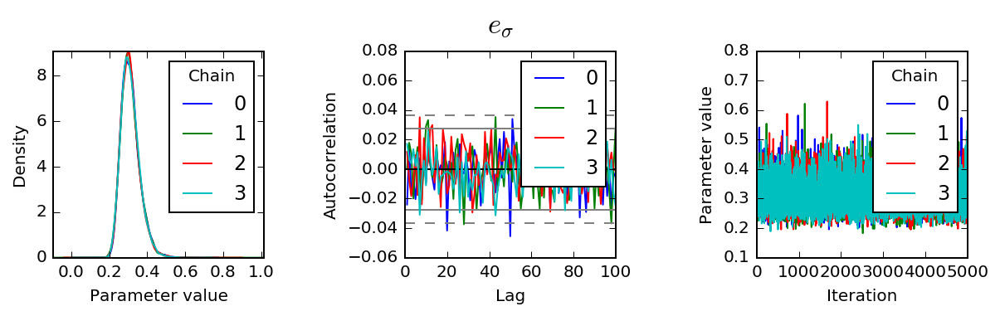

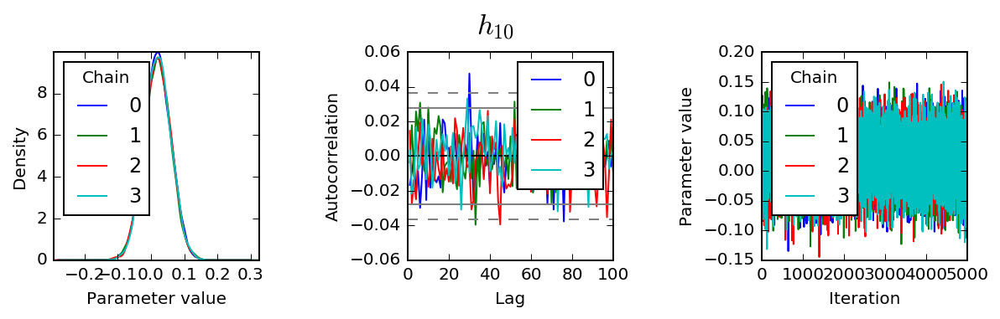

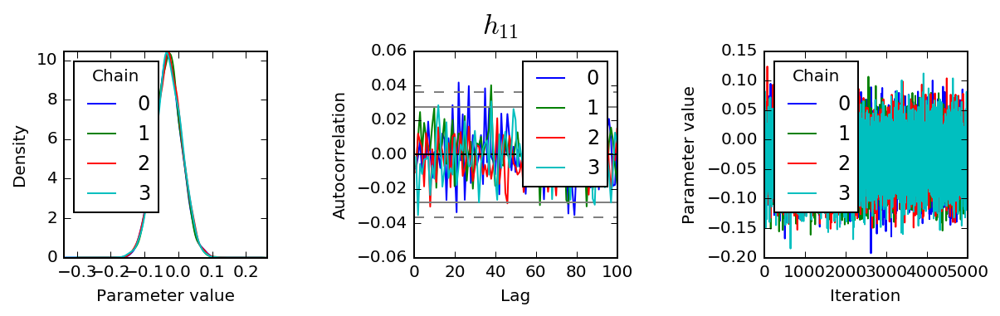

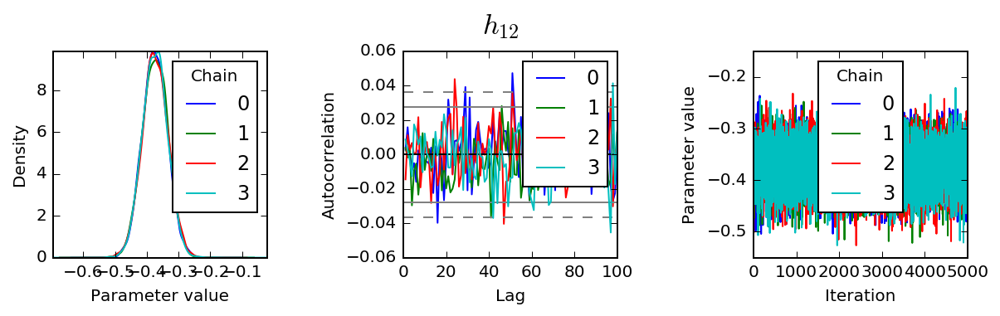

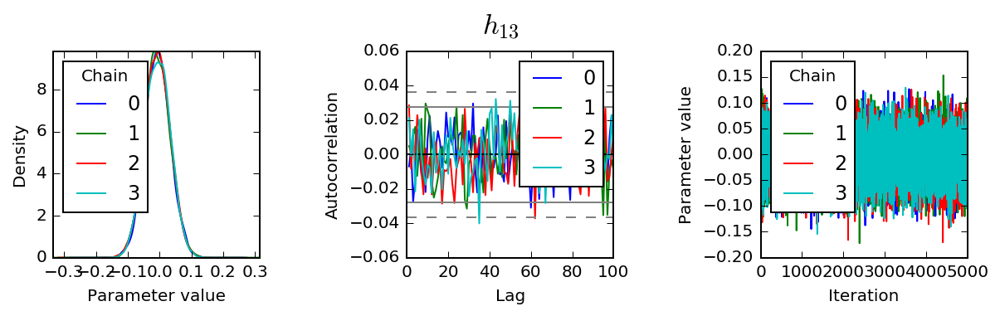

...

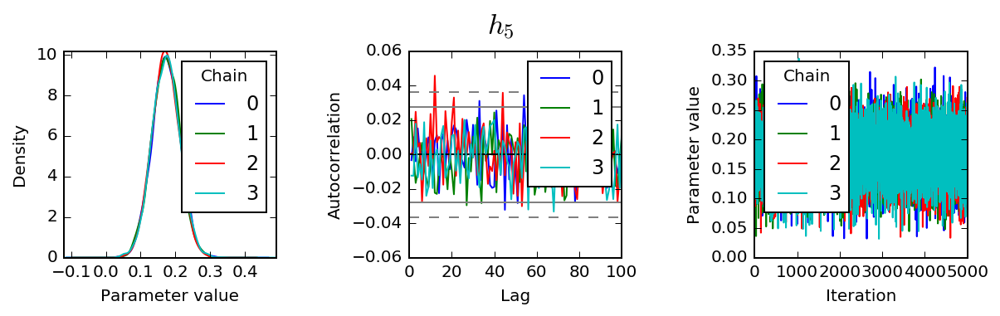

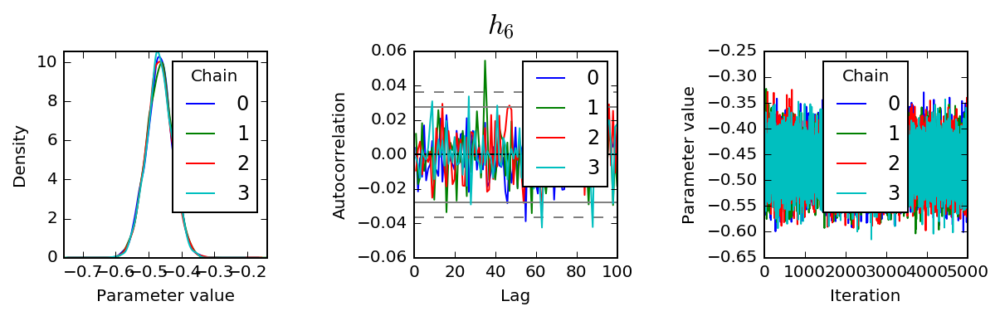

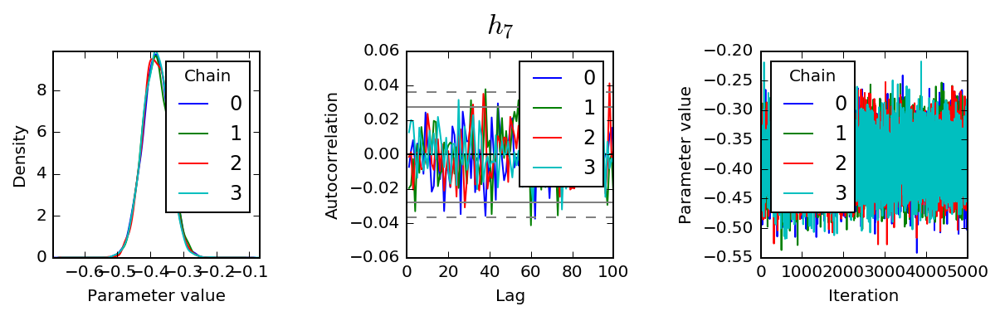

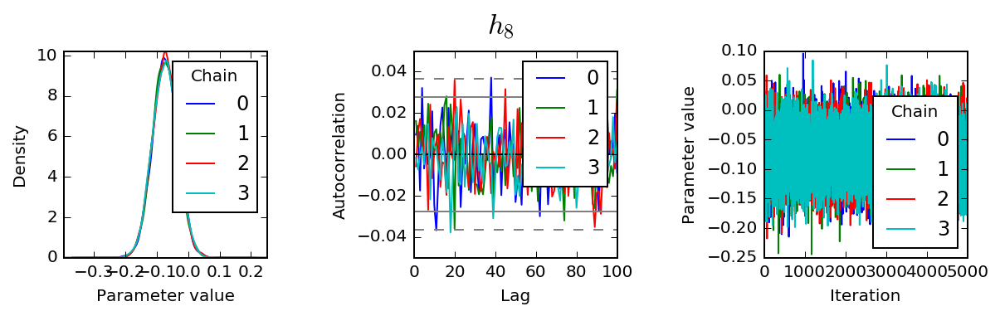

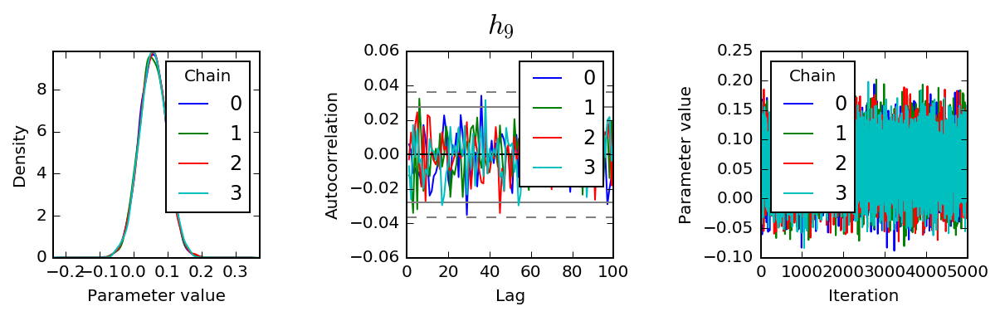

In [40]:
## Use pandas three dimensional Panel to represent the trace:

trace_1_Stan = pd.Panel({k: v for k, v in samples_Nm1_trace_Stan.items()})
trace_1_Stan.axes[0].name = 'Variable'
trace_1_Stan.axes[1].name = 'Iteration'
trace_1_Stan.axes[2].name = 'Chain'
 
## Point estimates:
print(trace_1_Stan.to_frame().mean())
 
## Bayesian equal-tailed 95% credible intervals:
print(trace_1_Stan.to_frame().quantile([0.05, 0.95]))
  ## ^ entering the values here could be a good question part
    
def plot(trace, var):
    fig, axes = plt.subplots(1, 3, figsize=(9, 3))
    fig.suptitle(var, y=0.95, fontsize='xx-large')
 
    ## Marginal posterior density estimate:
    trace[var].plot.density(ax=axes[0])
    axes[0].set_xlabel('Parameter value')
    axes[0].locator_params(tight=True)
 
    ## Autocorrelation for each chain:
    axes[1].set_xlim(0, 100)
    for chain in trace[var].columns:
        autocorrelation_plot(trace[var,:,chain], axes[1], label=chain)
 
    ## Trace plot:
    axes[2].set_ylabel('Parameter value')
    trace[var].plot(ax=axes[2])
 
    ## Save figure
    filename = var.replace("\\", "") 
    filename = filename.replace("$", "") 
    filename = filename.replace("}", "") 
    filename = filename.replace("{", "") 
    plt.tight_layout(pad=3)
    fig.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/Nm1_Stan/Nm1_'+'{}.png'.format(filename))
 
# Display diagnostic plots
for var in trace_1_Stan:
    plot(trace_1_Stan, var)
 


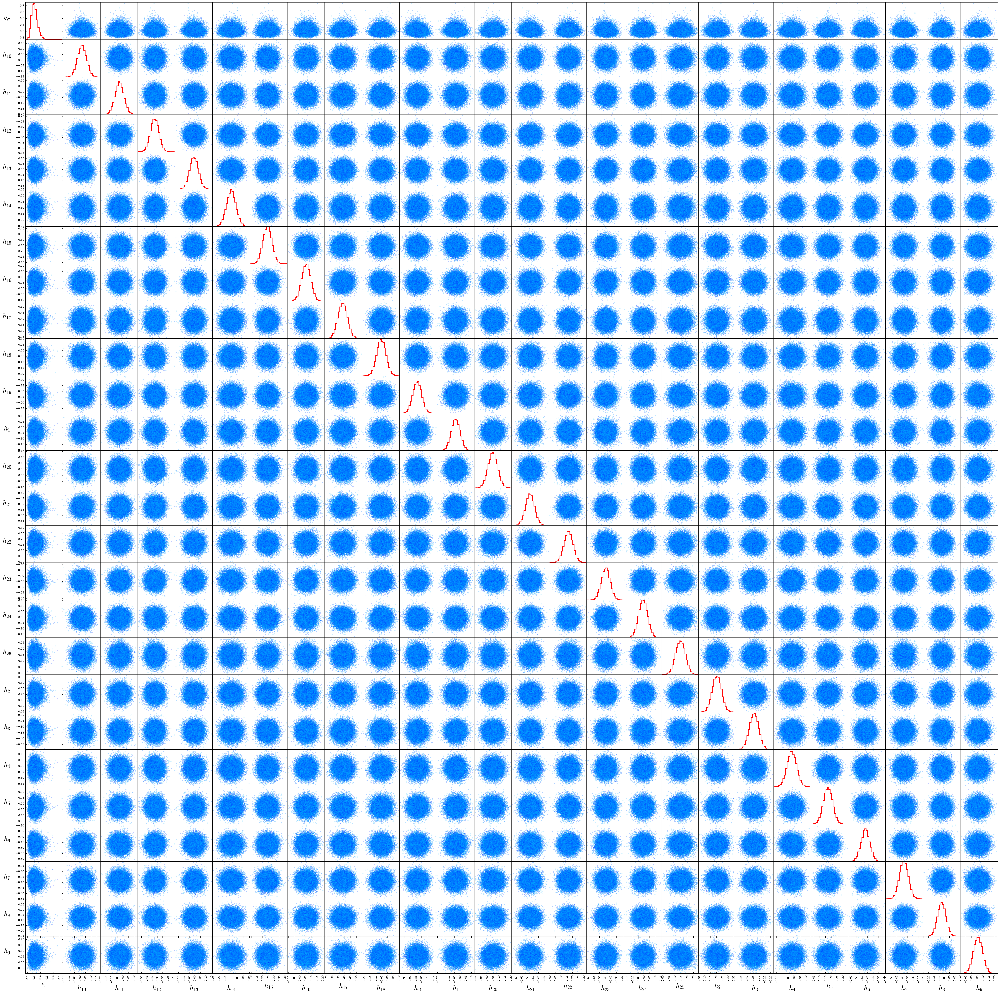

In [41]:
## Scatter matrix plot:
##    If Ndata is increase, this scatter_matrix might do better to skip every nth latent variable
##    Code for that is in a future code cell, where we make a triangle plot with KDE for 
##    joint 2D marginals. scatter_matrix is a Python Pandas module.

sm = scatter_matrix(trace_1_Stan.to_frame(),  color="#00BFFF", alpha=0.2, figsize=(dim1*2, dim1*2), diagonal='hist',hist_kwds={'bins':25,'histtype':'step', 'edgecolor':'r','linewidth':2})

## y labels size
[plt.setp(item.yaxis.get_label(), 'size', 20) for item in sm.ravel()]

## x labels size 
[plt.setp(item.xaxis.get_label(), 'size', 20) for item in sm.ravel()]

## Change label rotation.  This is helpful for very long labels
#[s.xaxis.label.set_rotation(45) for s in sm.reshape(-1)]

[s.xaxis.label.set_rotation(0) for s in sm.reshape(-1)]
[s.yaxis.label.set_rotation(0) for s in sm.reshape(-1)]

## May need to offset label when rotating to prevent overlap of figure
[s.get_yaxis().set_label_coords(-0.5,0.5) for s in sm.reshape(-1)]

## Hide all ticks
#[s.set_xticks(()) for s in sm.reshape(-1)]
#[s.set_yticks(()) for s in sm.reshape(-1)]

## Save the figure as .png 
plt.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/scatter_matrix_Nm1_Stan.png')


In [47]:

## Redefine the trace so that we only vizualize every #th latent variable element in 
## the scatter_matrix plot below. Vizualizing all Ndata is too cumbersome for the scatter
## matrix. 

## adjust the thin varible to only look at every #th population element 
##Ndata is 25 use 
thin = 5
##Ndata is 20 use
#thin = 4

## Re-specify the dimension we want for our plot below, with thinning, for legibility.  
dim2 = (Ndata/thin) + numHyperParams
print(dim2)

samples_Nm1_triangle_1_Stan = {}
truths_hhat = {}
truths_h = {}
for i in np.arange(0,Ndata,thin):
    samples_Nm1_triangle_1_Stan.update({'$h_{'+str(i+1)+'}$': samples_Stan['h'][:,i]})
    truths_hhat.update({'$h_{'+str(i+1)+'}$': hhat[i]})
    truths_h.update({'$h_{'+str(i+1)+'}$': h[i]})
samples_Nm1_triangle_1_Stan.update({'$e_{\sigma}$': samples_Stan['e_sigma']})
truths_hhat.update({'$e_{\sigma}$': sigmae})
truths_h.update({'$e_{\sigma}$': sigmae})

## Reshape values for diagnostic plot functions (trace, autocorrelation, scatter_matrix):  
#samples_Nm1_triangle_trace_Stan = {}    
#for j, i in samples_Nm1_triangle_Stan.items():
#    samples_Nm1_triangle_trace_Stan.update({str(j): i.reshape(int(len(i)/num_chains),-1)})
#
#print(list(samples_Nm1_scatter_matrix_trace.items()))
#print(list(samples_Nm1_scatter_matrix_trace['$h_{6}$'][0]))



6.0


In [48]:
#trace_2.to_frame()
print(samples_Nm1_triangle_1_Stan.keys())
print(5000*num_chains)
print(int(dim2))
print(truths_hhat.values())

['$h_{16}$', '$h_{21}$', '$h_{6}$', '$e_{\\sigma}$', '$h_{1}$', '$h_{11}$']
20000
6
[0.057349326850025376, -0.53323758104182473, -0.47575205682710575, 0.3, -0.039361908146152473, -0.030639404251275683]


(20000, 6)


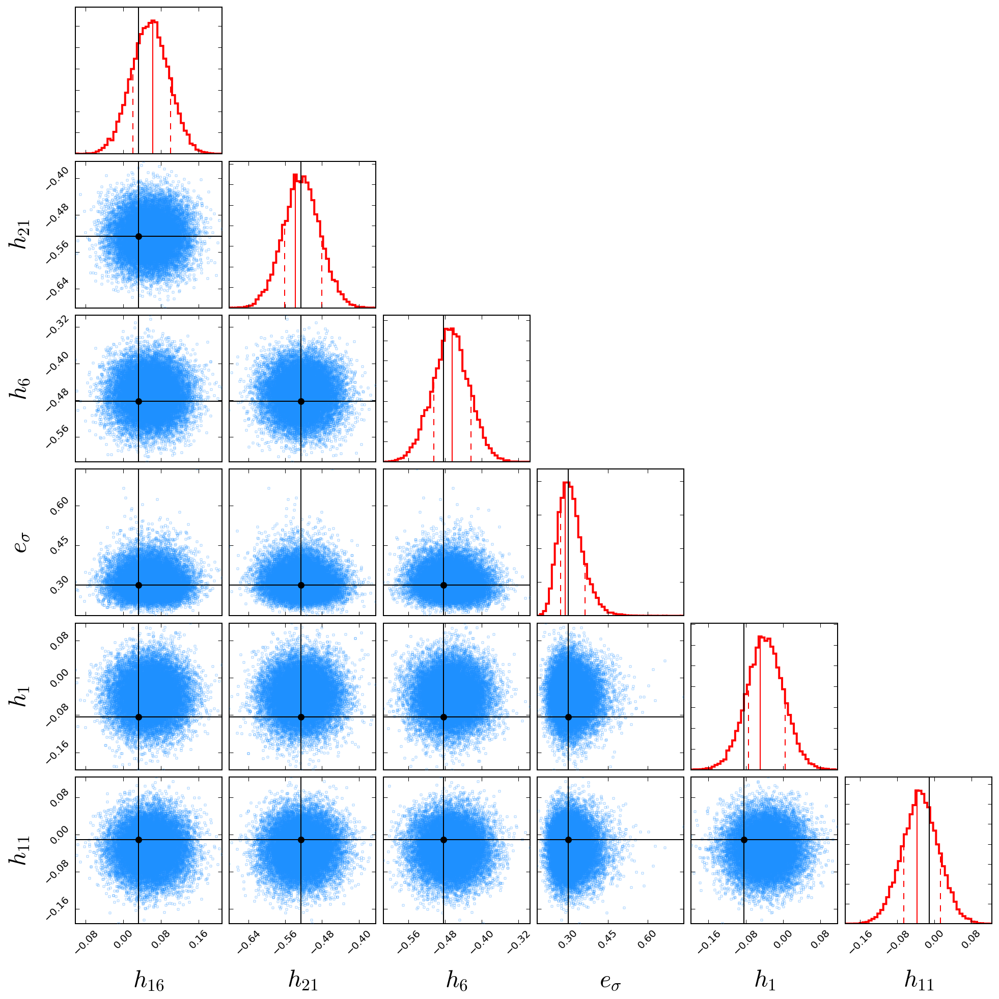

In [49]:

#data = np.asarray(samples_Nm1_scatter_matrix_triangle.values()).reshape((5000*num_chains),int(dim2))
#print(np.asarray(samples_Nm1_scatter_matrix_triangle.values()).reshape((5000*num_chains),int(dim2)).shape)

samples_Nm1_triangle_2_Stan = {}    
for j, i in samples_Nm1_triangle_1_Stan.items():
    samples_Nm1_triangle_2_Stan.update({str(j): i.reshape(-1,1)})
    
data = None
for k, v in samples_Nm1_triangle_2_Stan.items():
    column = v.reshape(-1,1)
    if data is None:
        data = column
    else:
        data = np.hstack((data, column))

print(data.shape)

figure = triangle_linear.corner(data,labels=samples_Nm1_triangle_2_Stan.keys(),labelsy=samples_Nm1_triangle_2_Stan.keys(), truths=truths_h.values(), truths_color = 'black')

plt.savefig('/Users/meganshabram/Dropbox/NASA_Postdoctoral_Program_Fellowship/LSSTC DSFP Session 4 Workshop/Plots2/triangle_linear_Nm1_Stan.png')


In [9]:
from IPython.display import display, Math, Latex
display(Math(r'\sqrt{a^2 + b^2}')) 



<IPython.core.display.Math object>

$$c = \sqrt{a^2 + b^2}$$

TO DO
    - [DONE!] get dataframe working properly, try pandas?
    - look at output more, explore shrinkage? 
    - explore draws from the posterior plotted as normals on top of data
    - explore an NM2 model in the framework on an Nm1 analysis
    - What happens when you inrease the fractional uncertainty?, what may solve this?
    - third notebook with breakpoint model? eclipsing binary data that is real? (dont save posteriors for each latent value here).  
    - plot truths in scatter plot? plot truths on histograms 
    - separete missing autocorrelation plots here. 
    - Truths, h or hhat?